In [34]:
# !pip install plotly
# !pip install -U kaleido
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import math
plt.style.use('ggplot')

import plotly.express as px
import warnings
import kaleido

warnings.filterwarnings("ignore")

In [35]:
df = pd.read_csv('clean_df_large.csv')

In [36]:
# Deleting columns that track indices
del df[df.columns[0]]
del df[df.columns[0]]

In [37]:
df

,Age,work class,fnlwgt,education,education-num,marital-status,occupation,relationship,race,sex,capital-gain,capital-loss,hours-per-week,native-country,income-binary
0,26,Private,0.000016,Bachelors,13,Married-civ-spouse,Exec-managerial,Wife,White,Female,0,0,45,United-States,1
1,26,Private,0.000016,Bachelors,13,Married-civ-spouse,Exec-managerial,Wife,White,Female,0,0,45,United-States,1
2,26,Private,0.000016,Bachelors,13,Married-civ-spouse,Exec-managerial,Wife,White,Female,0,0,45,United-States,1
3,26,Private,0.000016,Bachelors,13,Married-civ-spouse,Exec-managerial,Wife,White,Female,0,0,45,United-States,1
4,26,Private,0.000016,Bachelors,13,Married-civ-spouse,Exec-managerial,Wife,White,Female,0,0,45,United-States,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
266496,37,Private,0.000044,Assoc-voc,11,Divorced,Prof-specialty,Not-in-family,White,Female,8614,0,45,United-States,1
266497,37,Private,0.000044,Assoc-voc,11,Divorced,Prof-specialty,Not-in-family,White,Female,8614,0,45,United-States,1
266498,37,Private,0.000044,Assoc-voc,11,Divorced,Prof-specialty,Not-in-family,White,Female,8614,0,45,United-States,1
266499,37,Private,0.000044,Assoc-voc,11,Divorced,Prof-specialty,Not-in-family,White,Female,8614,0,45,United-States,1


In [38]:
# Change all categorical variables into numerical labels
df[" work class"].replace(df[" work class"].unique(), range(len(df[" work class"].unique())), inplace=True)
df[" education-num"].replace(df[" education-num"].unique(), range(len(df[" education-num"].unique())), inplace=True)
df[" marital-status"].replace(df[" marital-status"].unique(), range(len(df[" marital-status"].unique())), inplace=True)
df[" occupation"].replace(df[" occupation"].unique(), range(len(df[" occupation"].unique())), inplace=True)
df[" relationship"].replace(df[" relationship"].unique(), range(len(df[" relationship"].unique())), inplace=True)
df[" race"].replace(df[" race"].unique(), range(len(df[" race"].unique())), inplace=True)
df[" sex"].replace(df[" sex"].unique(), range(len(df[" sex"].unique())), inplace=True)
df[" native-country"].replace(df[" native-country"].unique(), range(len(df[" native-country"].unique())), inplace=True)

# Normalize all of the numerical variables
df["Age"] = (df["Age"]-df["Age"].mean())/df["Age"].std()
df[" education-num"] = (df[" education-num"]-df[" education-num"].mean())/df[" education-num"].std()
df[" capital-gain"] = (df[" capital-gain"]-df[" capital-gain"].mean())/df[" capital-gain"].std()
df[" capital-loss"] = (df[" capital-loss"]-df[" capital-loss"].mean())/df[" capital-loss"].std()
df[" hours-per-week"] = (df[" hours-per-week"]-df[" hours-per-week"].mean())/df[" hours-per-week"].std()


In [40]:
# Take another data set just to run histogram analysis
# We will still use df to run machine learning models.
df2 = pd.read_csv('clean_df_large.csv')
del df2[df2.columns[0]]
del df2[df2.columns[0]]
del df2[df2.columns[2]]
df2 = df2.sample(frac = 1)
df2 = df2.reset_index()
del df2[df2.columns[0]]
df2 = df2[~(df2 == '?').any(axis=1)]

Exploratory Data Analysis (Histogram Analysis)

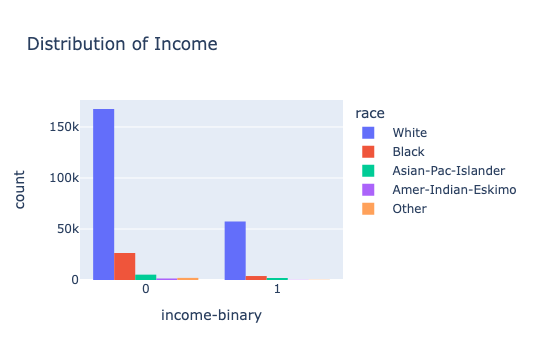

In [42]:
fig=px.histogram(df2, 
                 x=" income-binary",
                 color=" race",
                 hover_data=df2.columns,
                 title="Distribution of Income",
                 barmode="group")
fig.show()

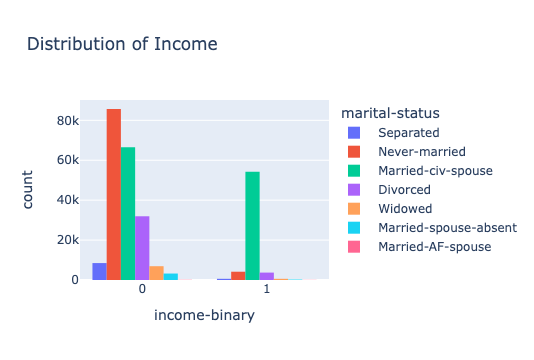

In [44]:
fig=px.histogram(df2, 
                 x=" income-binary",
                 color=" marital-status",
                 hover_data=df2.columns,
                 title="Distribution of Income",
                 barmode="group")
fig.show()

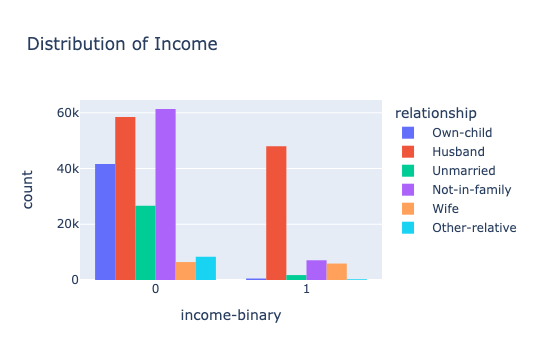

In [45]:
fig=px.histogram(df2, 
                 x=" income-binary",
                 color=" relationship",
                 hover_data=df2.columns,
                 title="Distribution of Income ",
                 barmode="group")
fig.show()

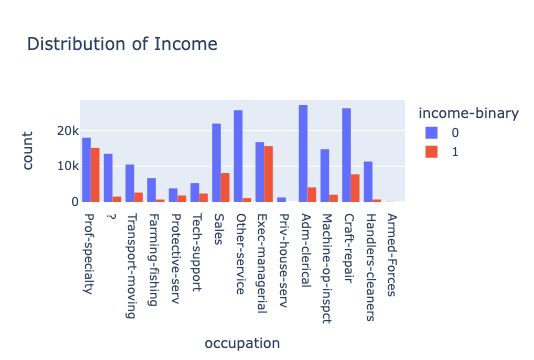

In [46]:
fig=px.histogram(df2, 
                 x=" occupation",
                 color=" income-binary",
                 hover_data=df2.columns,
                 title="Distribution of Income",
                 barmode="group")
fig.show()

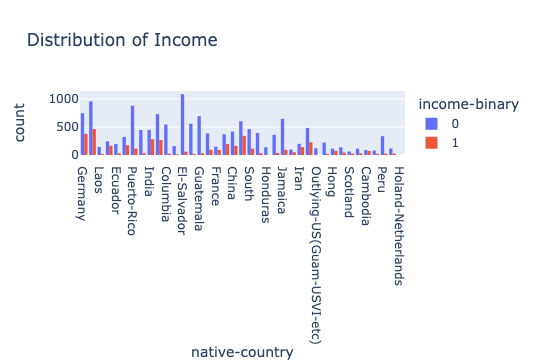

In [47]:
# Drop rows with US or Mexico (will oversaturate the histogram)
df2.drop(df2[df2[' native-country'] == " United-States"].index, inplace = True)
df2.drop(df2[df2[' native-country'] == " ?"].index, inplace = True)
df2.drop(df2[df2[' native-country'] == " Mexico"].index, inplace = True)

fig=px.histogram(df2, 
                 x=" native-country",
                 color=" income-binary",
                 hover_data=df2.columns,
                 title="Distribution of Income ",
                 barmode="group")
fig.show()

Box and Whisker Analysis for Continuous Variables

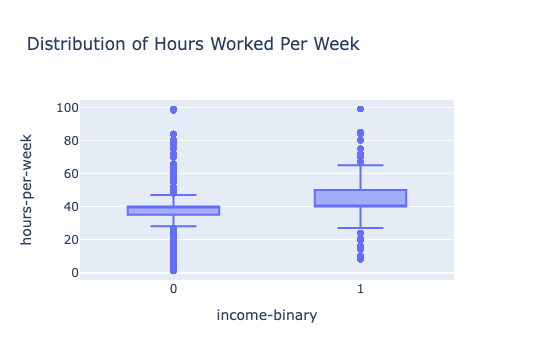

In [48]:
fig=px.box(df2,y=" hours-per-week",x=" income-binary",title=f"Distribution of Hours Worked Per Week")
fig.show()

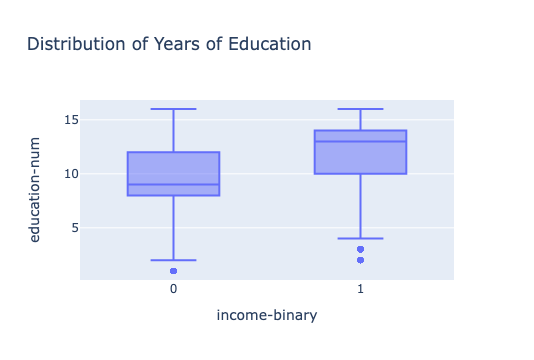

In [49]:
fig = px.box(df2,y=" education-num",x=" income-binary",title=f"Distribution of Years of Education")
fig.show()